In [1]:
# Set the first GPU as visible
%env CUDA_VISIBLE_DEVICES=2

env: CUDA_VISIBLE_DEVICES=2


In [15]:
import cv2
import sys
import torch
import numpy as np

sys.path.append('/home/sebastian.cavada/scsv/thesis/mast3r_mine')
import mast3r.utils.path_to_dust3r  # noqa

from dust3r.inference import inference
from dust3r.model import AsymmetricCroCo3DStereo
from dust3r.utils.image import load_images
from dust3r.image_pairs import make_pairs
from dust3r.cloud_opt import global_aligner, GlobalAlignerMode

from mast3r.model import AsymmetricMASt3R

import matplotlib.pyplot as plt
import imageio.v2 as imageio

import torch
import torch.nn.functional as F

import os
import json

import numpy as np
from pathlib import Path

# Specify the folder containing JSON files
folder_path = './arkitscenes_pairs/Test'

file_name = folder_path + "/scene_list.json"
print(file_name)

with open(file_name, 'r') as file:
    scene_list = json.load(file)

    print(scene_list)

gt_path = Path('/data3/sebastian.cavada/datasets/arkitscenes_test/Test')

./arkitscenes_pairs/Test/scene_list.json
['45663206', '41126514', '45261728', '41126453', '45261201', '45261164', '41126467', '47204861', '41249059', '41126383', '41126554', '41126500', '47204856', '47204325', '41126619', '45261228', '45261203', '41249065', '41126534', '41126307', '47204842', '45261230', '41126598', '41159368', '41126439', '41126541', '41126567', '41126516', '45663205', '41126597', '41126367', '45261246', '41126305', '45261248', '47204319', '45261277', '41126417', '41126446', '45261713', '41126589', '41126401', '41159375', '45261167', '41125976', '41126526', '41125937', '41159369', '45261689', '45261251', '45261681', '47204330', '41126518', '41249056', '41126550', '45261265', '41126543', '41126580', '45261172', '47204341', '41392191', '41126297', '41126498', '41159381', '41126466', '45261158', '45261709', '47204322', '47204836', '41126592', '45261269', '41125972', '41126494', '41126533', '45261169', '45261206', '45261686', '45261662', '41249063', '47204350', '41126603'

In [3]:
def todevice(batch, device, callback=None, non_blocking=False):
    ''' Transfer some variables to another device (i.e. GPU, CPU:torch, CPU:numpy).

    batch: list, tuple, dict of tensors or other things
    device: pytorch device or 'numpy'
    callback: function that would be called on every sub-elements.
    '''
    if callback:
        batch = callback(batch)

    if isinstance(batch, dict):
        return {k: todevice(v, device) for k, v in batch.items()}

    if isinstance(batch, (tuple, list)):
        return type(batch)(todevice(x, device) for x in batch)

    x = batch
    if device == 'numpy':
        if isinstance(x, torch.Tensor):
            x = x.detach().cpu().numpy()
    elif x is not None:
        if isinstance(x, np.ndarray):
            x = torch.from_numpy(x)
        if torch.is_tensor(x):
            x = x.to(device, non_blocking=non_blocking)
    return x


to_device = todevice  # alias


def to_numpy(x): return todevice(x, 'numpy')
def to_cpu(x): return todevice(x, 'cpu')
def to_cuda(x): return todevice(x, 'cuda')

if __name__ == '__main__':
    device = 'cuda'
    batch_size = 1
    schedule = 'cosine'
    lr = 0.01
    niter = 300

    model_name = "naver/MASt3R_ViTLarge_BaseDecoder_512_catmlpdpt_metric"
    # you can put the path to a local checkpoint in model_name if needed
    model = AsymmetricMASt3R.from_pretrained(model_name).to(device)
    # load_images can take a list of images or a directory

    # the idea is, load the image pairs from dust3r and use them to do inference
    # for each pair compute the various distances BLABLA and let them evaluate

    # img_list = ['/data3/sebastian.cavada/datasets/arkitscenes_test/Test/45663206/vga_wide/45663206_65708.102.jpg', '/data3/sebastian.cavada/datasets/arkitscenes_test/Test/45663206/vga_wide/45663206_65680.214.jpg']
    img_list = ['/data3/sebastian.cavada/datasets/arkitscenes_test/Test/41126453/vga_wide/41126453_4653.488.jpg', '/data3/sebastian.cavada/datasets/arkitscenes_test/Test/41126453/vga_wide/41126453_4652.088.jpg']    

    images = load_images(img_list, size=512)
    pairs = make_pairs(images, scene_graph='complete', prefilter=None, symmetrize=True)
    output = inference(pairs, model, device, batch_size=batch_size)

    # at this stage, you have the raw dust3r predictions
    view1, pred1 = output['view1'], output['pred1']
    view2, pred2 = output['view2'], output['pred2']
    # here, view1, pred1, view2, pred2 are dicts of lists of len(2)
    #  -> because we symmetrize we have (im1, im2) and (im2, im1) pairs
    # in each view you have:
    # an integer image identifier: view1['idx'] and view2['idx']
    # the img: view1['img'] and view2['img']
    # the image shape: view1['true_shape'] and view2['true_shape']
    # an instance string output by the dataloader: view1['instance'] and view2['instance']
    # pred1 and pred2 contains the confidence values: pred1['conf'] and pred2['conf']
    # pred1 contains 3D points for view1['img'] in view1['img'] space: pred1['pts3d']
    # pred2 contains 3D points for view2['img'] in view1['img'] space: pred2['pts3d_in_other_view']

    # next we'll use the global_aligner to align the predictions
    # depending on your task, you may be fine with the raw output and not need it
    # with only two input images, you could use GlobalAlignerMode.PairViewer: it would just convert the output
    # if using GlobalAlignerMode.PairViewer, no need to run compute_global_alignment

    scene = global_aligner(output, device=device, mode=GlobalAlignerMode.PointCloudOptimizer)
    loss = scene.compute_global_alignment(init="mst", niter=niter, schedule=schedule, lr=lr)

    # show pred1 and pred2 in image
    # also return rgb, depth and confidence imgs
    # depth is normalized with the max value for all images
    # we apply the jet colormap on the confidence maps

    # combined_image = np.hstack((depths[0], depths[1]))
    # cv2.imshow('Combined Image', combined_image)
    # cv2.waitKey(0)
    # cv2.destroyAllWindows()

    # cmap = pl.get_cmap('jet')
    # depths_max = max([d.max() for d in depths])
    # depths = [d / depths_max for d in depths]
    # confs_max = max([d.max() for d in confs])
    # confs = [cmap(d / confs_max) for d in confs]

config.json:   0%|          | 0.00/546 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/2.75G [00:00<?, ?B/s]

>> Loading a list of 2 images
 - adding /data3/sebastian.cavada/datasets/arkitscenes_test/Test/41126453/vga_wide/41126453_4653.488.jpg with resolution 256x192 --> 512x384
 - adding /data3/sebastian.cavada/datasets/arkitscenes_test/Test/41126453/vga_wide/41126453_4652.088.jpg with resolution 256x192 --> 512x384
 (Found 2 images)
>> Inference with model on 2 image pairs


  0%|          | 0/2 [00:00<?, ?it/s]

ATTENTION intrinsics are not being used
ATTENTION extrinsics are not being used


/home/sebastian.cavada/scsv/thesis/mast3r_mine/dust3r/dust3r/inference.py:44: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(enabled=bool(use_amp)):
/home/sebastian.cavada/scsv/thesis/mast3r_mine/dust3r/dust3r/model.py:328: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(enabled=False):
/home/sebastian.cavada/scsv/thesis/mast3r_mine/dust3r/dust3r/inference.py:48: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(enabled=False):
100%|██████████| 2/2 [00:00<00:00,  4.89it/s]

ATTENTION intrinsics are not being used
ATTENTION extrinsics are not being used
 init edge (1*,0*) score=np.float64(6.84404182434082)


 init loss = 0.011169729754328728
Global alignement - optimizing for:
['pw_poses', 'im_depthmaps', 'im_poses', 'im_focals']


100%|██████████| 300/300 [00:04<00:00, 73.33it/s, lr=1.27413e-06 loss=0.00858329]


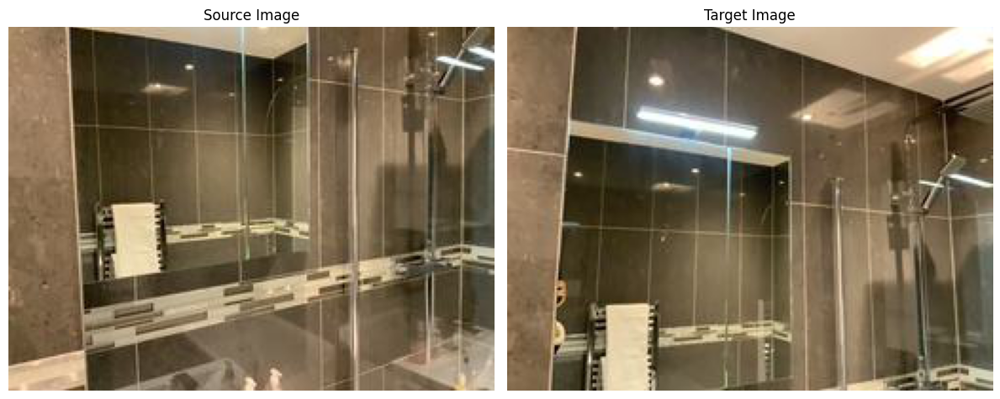

In [9]:
src_rgb_image = imageio.imread(img_list[0])
target_rgb_image = imageio.imread(img_list[1])

# Create a figure with two subplots side by side
fig, axes = plt.subplots(1, 2, figsize=(12, 6))

# Display the source depth image
axes[0].imshow(src_rgb_image)  # Use 'gray' colormap for depth maps
axes[0].set_title('Source Image')
axes[0].axis('off')  # Hide axis

# Display the target depth image
axes[1].imshow(target_rgb_image)
axes[1].set_title('Target Image')
axes[1].axis('off')

# Adjust layout and display
plt.tight_layout()
plt.show()

(384, 512)


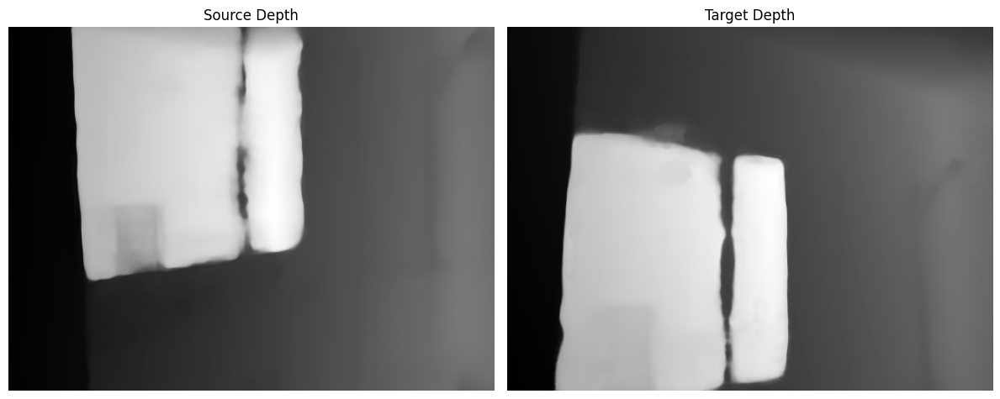

In [10]:
rgbimg = scene.imgs
depths = to_numpy(scene.get_depthmaps())
confs = to_numpy([c for c in scene.im_conf])

print(depths[0].shape)

#concat the two images and show them

# gray_image = cv2.cvtColor(rgbimg[0], cv2.COLOR_RGB2GRAY)

fig, axes = plt.subplots(1, 2, figsize=(12, 6))

# Display the source depth image
axes[0].imshow(depths[0], cmap='gray')  # Use 'gray' colormap for depth maps
axes[0].set_title('Source Depth')
axes[0].axis('off')  # Hide axis

# Display the target depth image
axes[1].imshow(depths[1], cmap='gray')
axes[1].set_title('Target Depth')
axes[1].axis('off')

# Adjust layout and display
plt.tight_layout()
plt.show()

In [11]:
pts3d_img1 = pred1['pts3d'][0].detach().cpu().numpy()


In [12]:
type(src_rgb_image)

numpy.ndarray

In [13]:
import plotly.graph_objects as go
import numpy as np

def plot_3d_points_with_color(points, colors=None, valid_mask=None):

    """
    Plots 3D points with RGB colors interactively.
    
    Parameters:
        points (numpy array): 3D points with shape (N, 3).
        colors (numpy array): RGB colors for each point (N, 3) in [0, 255] format.
        valid_mask (numpy array): Optional mask to filter points (shape N, boolean array).
    """
    print(valid_mask.shape)
    print(points.shape)
    print(colors.shape)
    # print(sum(valid_mask))
    if valid_mask is not None:
        points = points[valid_mask]
        if colors is not None:
            colors = colors[valid_mask]

    # Normalize RGB values to [0, 1] for Plotly
    if colors is not None:
        colors = colors / 255.0        
        color_values = ['rgb({:.0f},{:.0f},{:.0f})'.format(c[0] * 255, c[1] * 255, c[2] * 255) for c in colors]
    else:
        color_values = 'blue'  # Default color if no RGB is provided

    # Create the scatter3D plot
    scatter = go.Scatter3d(
        x=points[:, 0],
        y=points[:, 1],
        z=points[:, 2],
        mode='markers',
        marker=dict(
            size=2,
            color=color_values,  # Set marker color
        )
    )

    layout = go.Layout(
        scene=dict(
            xaxis_title='X',
            yaxis_title='Y',
            zaxis_title='Z',
        ),
        title='Interactive 3D Points with RGB Colors',
    )

    fig = go.Figure(data=[scatter], layout=layout)
    fig.show(renderer="notebook")

# Example usage:
# Assuming `pts3d_img2` is your (N, 3) array of points
# Assuming `rgb_colors` is your (N, 3) array of RGB values in [0, 255]
# Assuming `valid_mask_img1` is your boolean mask for valid points

scale_factor = 2  # Upscaling by a factor of 2
test = torch.tensor(target_rgb_image).unsqueeze(0).permute(0,3,1,2)
# print(test.shape)
upscaled_image = F.interpolate(test, scale_factor=scale_factor, mode='bilinear', align_corners=False)
# print(upscaled_image.shape)
valid_mask = np.full((upscaled_image.shape[2], upscaled_image.shape[3]), True)
# print(valid_mask.shape)

plot_3d_points_with_color(pts3d_img1, colors=upscaled_image.squeeze(0).permute(1,2,0).detach().cpu().numpy(), valid_mask=valid_mask)

(384, 512)
(384, 512, 3)
(384, 512, 3)


In [40]:
torch.tensor(src_rgb_image).unsqueeze(0).shape

torch.Size([1, 192, 256, 3])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


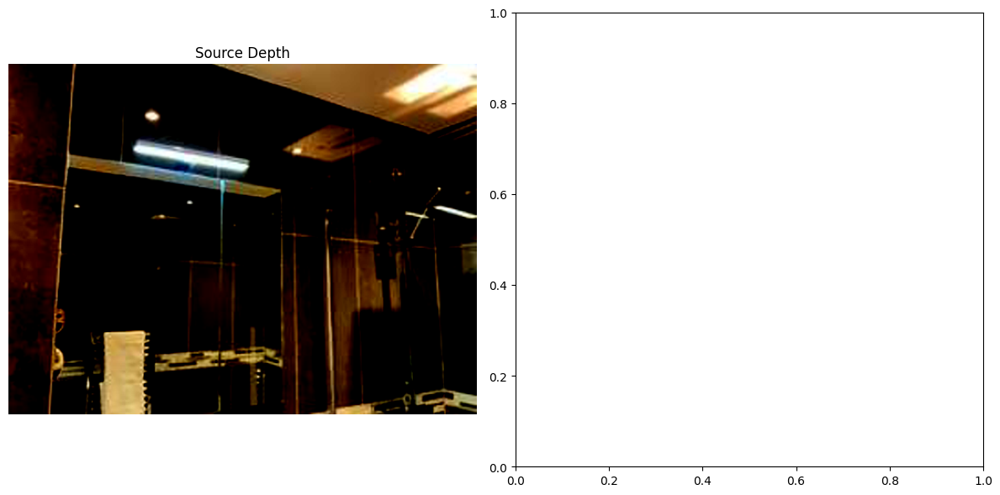

In [42]:
fig, axes = plt.subplots(1, 2, figsize=(12, 6))

# Display the source depth image
axes[0].imshow(view1['img'][0].permute(1,2,0))  # Use 'gray' colormap for depth maps
axes[0].set_title('Source Depth')
axes[0].axis('off')  # Hide axis\

# Adjust layout and display
plt.tight_layout()
plt.show()

In [43]:
pts3d_img2 = pred2['pts3d_in_other_view'][0].detach().cpu().numpy()

scale_factor = 2  # Upscaling by a factor of 2
test = torch.tensor(target_rgb_image).unsqueeze(0).permute(0,3,1,2)
# print(test.shape)
upscaled_image = F.interpolate(test, scale_factor=scale_factor, mode='bilinear', align_corners=False)
# print(upscaled_image.shape)
valid_mask = np.full((upscaled_image.shape[2], upscaled_image.shape[3]), True)
# print(valid_mask.shape)

plot_3d_points_with_color(pts3d_img2, colors=upscaled_image.squeeze(0).permute(1,2,0).detach().cpu().numpy(), valid_mask=valid_mask)

(384, 512)
(384, 512, 3)
(384, 512, 3)


In [14]:
X_cam = pts3d_img1[:, :, 0]
Y_cam = pts3d_img1[:, :, 1]
Z_cam = pts3d_img1[:, :, 2]

f_u, f_v, c_u, c_v = gt_data['intrinsics'][int(pair[0])][2:]

print(f_u, f_v, c_u, c_v)

H, W, _ = target_rgb_image.shape
print(H, W)


u = (f_u * X_cam / Z_cam) + c_u
v = (f_v * Y_cam / Z_cam) + c_v

print(u.shape)

# Stack into (N, 2) array
pts_2d = np.stack([u, v], axis=-1)
print(pts_2d.shape)


NameError: name 'gt_data' is not defined

In [ ]:
def project_points_torch(pts_2d, target_rgb_image, image_height=192, image_width=256):
    """
    Vectorized point projection using PyTorch
    
    Args:
        pts_2d: Tensor of shape (N, M, 2) containing 2D coordinates
        target_rgb_image: Tensor of shape (N, M, 3) containing RGB values
        image_height: Height of the output image
        image_width: Width of the output image
    
    Returns:
        Projected image as a tensor
    """
    # Convert inputs to torch tensors if they aren't already
    if not isinstance(pts_2d, torch.Tensor):
        pts_2d = torch.from_numpy(pts_2d)
    if not isinstance(target_rgb_image, torch.Tensor):
        target_rgb_image = torch.from_numpy(target_rgb_image)
    
    # Create empty image tensor
    image = torch.zeros(image_height, image_width, 3, dtype=torch.uint8)
    
    # Round coordinates to integers
    pts_2d_int = pts_2d.round().long()
    
    # Clip coordinates to image boundaries
    pts_2d_int[..., 0] = torch.clamp(pts_2d_int[..., 0], 0, image_width - 1)
    pts_2d_int[..., 1] = torch.clamp(pts_2d_int[..., 1], 0, image_height - 1)
    
    # Flatten the point coordinates and RGB values
    flat_coords = pts_2d_int.reshape(-1, 2)
    flat_colors = target_rgb_image.reshape(-1, 3)
    
    # Use scatter_ to place RGB values at corresponding coordinates
    image[flat_coords[:, 1], flat_coords[:, 0]] = flat_colors
    
    return image

# Create the projected image
image = project_points_torch(pts_2d, target_rgb_image)

# Display the result
plt.imshow(image.numpy())
plt.title("Projected Points on 2D Image (Vectorized)")
plt.show()


In [47]:
sys.path.append('/home/sebastian.cavada/scsv/thesis/mast3r_mine/dust3r')

from dust3r.utils.geometry import depthmap_to_pts3d, depthmap_to_camera_coordinates, depthmap_to_absolute_camera_coordinates, inv, geotrf, normalize_pointcloud # nofq

norm_mode = "avg_dst"
gt_scale = False

def Sum(*losses_and_masks):
    loss, mask = losses_and_masks[0]
    if loss.ndim > 0:
        # we are actually returning the loss for every pixels
        return losses_and_masks
    else:
        # we are returning the global loss
        for loss2, mask2 in losses_and_masks[1:]:
            loss = loss + loss2
        return loss

def get_pred_pts3d(gt, pred, use_pose=False):
    if 'depth' in pred and 'pseudo_focal' in pred:
        try:
            pp = gt['camera_intrinsics'][..., :2, 2]
        except KeyError:
            pp = None
        pts3d = depthmap_to_pts3d(**pred, pp=pp)

    elif 'pts3d' in pred:
        # pts3d from my camera
        pts3d = pred['pts3d']

    elif 'pts3d_in_other_view' in pred:
        # pts3d from the other camera, already transformed
        assert use_pose is True
        return pred['pts3d_in_other_view']  # return!

    if use_pose:
        camera_pose = pred.get('camera_pose')
        assert camera_pose is not None
        pts3d = geotrf(camera_pose, pts3d)

    return pts3d

def get_all_pts3d(gt1, gt2, pred1, pred2, dist_clip=None):
    # everything is normalized w.r.t. camera of view1
    in_camera1 = inv(gt1['camera_pose'])
    gt_pts1 = geotrf(in_camera1, gt1['pts3d'])  # B,H,W,3
    gt_pts2 = geotrf(in_camera1, gt2['pts3d'])  # B,H,W,3

    valid1 = gt1['valid_mask'].clone()
    valid2 = gt2['valid_mask'].clone()

    if dist_clip is not None:
        # points that are too far-away == invalid
        dis1 = gt_pts1.norm(dim=-1)  # (B, H, W)
        dis2 = gt_pts2.norm(dim=-1)  # (B, H, W)
        valid1 = valid1 & (dis1 <= dist_clip)
        valid2 = valid2 & (dis2 <= dist_clip)

    pr_pts1 = get_pred_pts3d(gt1, pred1, use_pose=False)
    pr_pts2 = get_pred_pts3d(gt2, pred2, use_pose=True)

    # normalize 3d points
    if norm_mode:
        pr_pts1, pr_pts2 = normalize_pointcloud(pr_pts1, pr_pts2, norm_mode, valid1, valid2)
    if norm_mode and not gt_scale:
        gt_pts1, gt_pts2 = normalize_pointcloud(gt_pts1, gt_pts2, norm_mode, valid1, valid2)

    return gt_pts1, gt_pts2, pr_pts1, pr_pts2, valid1, valid2, {}

def test(gt1, gt2, pred1, pred2, **kw):
    # I guess that here the loss is computed for each 3D point in each view
    # this is great because we can have a loss for each point
    
    gt_pts1, gt_pts2, pred_pts1, pred_pts2, mask1, mask2, monitoring = \
        get_all_pts3d(gt1, gt2, pred1, pred2, **kw)

    print(gt_pts1)
        
    # # loss on img1 side
    # l1 = self.criterion(pred_pts1[mask1], gt_pts1[mask1])
    # # loss on gt2 side
    # l2 = self.criterion(pred_pts2[mask2], gt_pts2[mask2])
    # self_name = type(self).__name__
    # details = {self_name + '_pts3d_1': float(l1.mean()), self_name + '_pts3d_2': float(l2.mean())}
    # return Sum((l1, mask1), (l2, mask2)), (details | monitoring)

test(view1, view2, pred1, pred2, dist_clip=None)


KeyError: 'camera_pose'

In [48]:
print(view1)

{'img': tensor([[[[ 0.1608,  0.1608,  0.1529,  ...,  0.9373,  0.8902,  0.8745],
          [ 0.1608,  0.1608,  0.1529,  ...,  0.9451,  0.9059,  0.8902],
          [ 0.1686,  0.1686,  0.1608,  ...,  0.9608,  0.9294,  0.9216],
          ...,
          [ 0.0196,  0.0196,  0.0275,  ...,  0.1608,  0.2078,  0.2314],
          [ 0.0118,  0.0118,  0.0196,  ..., -0.1373, -0.0980, -0.0745],
          [ 0.0039,  0.0039,  0.0118,  ..., -0.2784, -0.2392, -0.2235]],

         [[-0.0745, -0.0745, -0.0824,  ...,  0.9686,  0.9294,  0.9059],
          [-0.0745, -0.0745, -0.0824,  ...,  0.9765,  0.9373,  0.9216],
          [-0.0667, -0.0667, -0.0745,  ...,  0.9843,  0.9608,  0.9529],
          ...,
          [-0.1765, -0.1765, -0.1686,  ...,  0.1216,  0.1686,  0.1922],
          [-0.1843, -0.1843, -0.1765,  ..., -0.1765, -0.1451, -0.1294],
          [-0.1922, -0.1922, -0.1843,  ..., -0.3176, -0.2941, -0.2784]],

         [[-0.3412, -0.3412, -0.3490,  ...,  1.0000,  1.0000,  1.0000],
          [-0.3412, -0